<a href="https://colab.research.google.com/github/krakenkhan/Data-Driven-Strategic-Management/blob/main/DDSM_finalproject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import kagglehub
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import os
import pandas as pd
import xlrd

## **Loading and Preprocessing The Data**

In [2]:
# Load edges
edges_df = pd.read_csv("/content/drive/MyDrive/dataset/fb-pages-tvshow-edges.csv", header=None, names=["source", "target"])

# Load nodes
nodes_df = pd.read_csv("/content/drive/MyDrive/dataset/fb-pages-tvshow-nodes.csv")

# Create a graph
G = nx.Graph()

# Add nodes
for _, row in nodes_df.iterrows():
    G.add_node(row["new_id"], name=row["name"], original_id=row["id"])

# Add edges
for _, row in edges_df.iterrows():
    G.add_edge(row["source"], row["target"])

# Print basic graph info
print(f"Number of nodes: {G.number_of_nodes()}")
print(f"Number of edges: {G.number_of_edges()}")

Number of nodes: 3892
Number of edges: 17262


# Visulisation

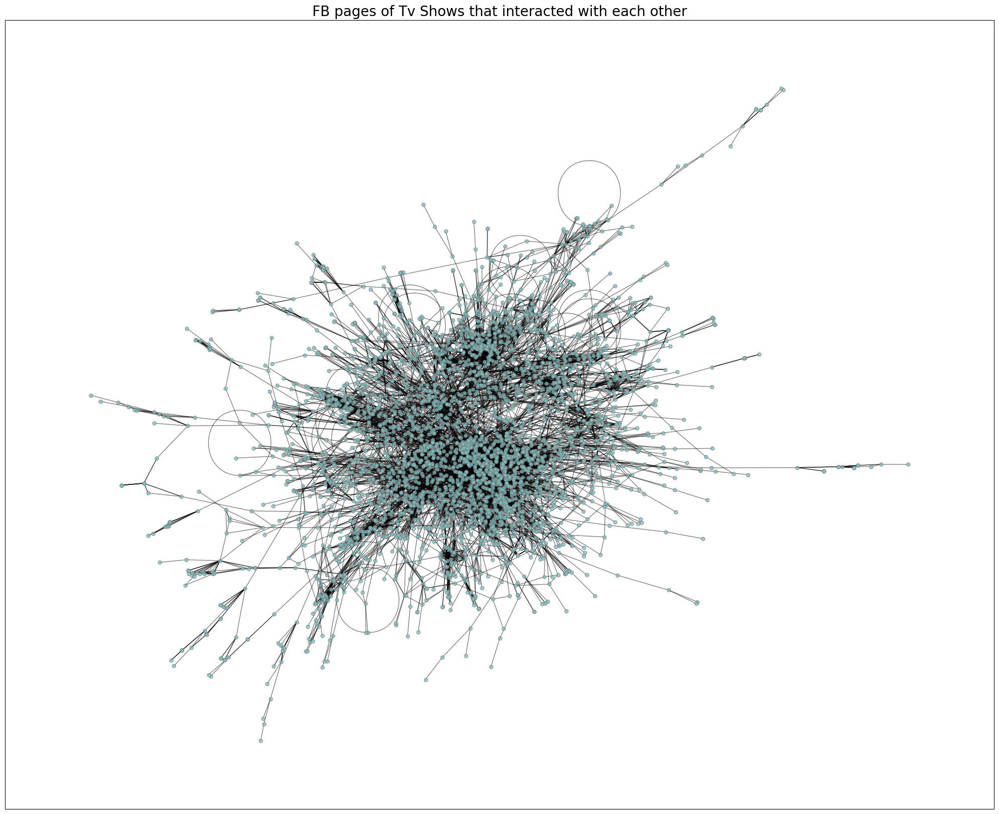

In [3]:
size = 20
title = "FB pages of Tv Shows that interacted with each other"
fig, ax = plt.subplots(figsize=(size, size-4))
pos = nx.spring_layout(G, seed=42)

# nodes
options = {"edgecolors": "tab:gray", "node_size": 25, "alpha": 0.75}
nx.draw_networkx_nodes(G, pos, node_color=["#76c8c8"], **options)

# edges
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.5)

#labels
# nx.draw_networkx_labels(G,pos, font_size=8)

plt.tight_layout()
plt.title(title, fontsize=20)
plt.axis("on")
plt.show()


# Network Analysis

**Degree Distribution Analysis**

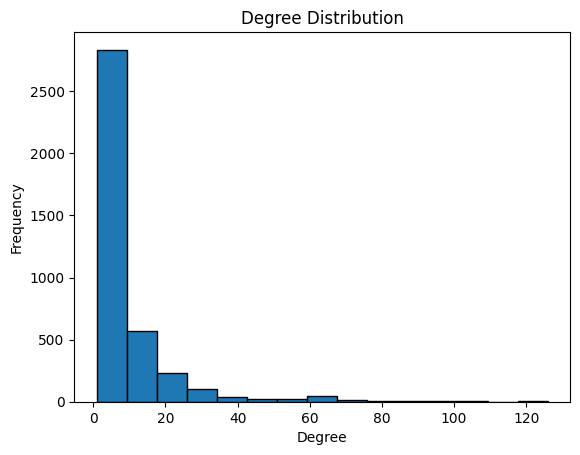

In [4]:
def degree_dist(G):
  # Degree Distribution:
  degrees = [deg for _, deg in G.degree()]
  plt.hist(degrees, bins=15, edgecolor='black')
  plt.xlabel("Degree")
  plt.ylabel("Frequency")
  plt.title("Degree Distribution")
  plt.show()
degree_dist(G)


---
The degree distribution is highly skewed, indicating a few highly connected nodes while most have low connectivity.

The degree distribution is highly skewed, with a small number of highly connected nodes and a majority of nodes are low in terms of connectivity.
The first bar in the histogram is significantly larger, that means that most nodes have low degrees it meants that there is a scale-free or power-law distribution.


---



**Connected Components Analysis**

In [5]:
def concomp(G):
  num_components = nx.number_connected_components(G)
  largest_cc = max(nx.connected_components(G), key=len)
  largest_subgraph = G.subgraph(largest_cc)
  print(f"Number of connected components: {num_components}")
  print(f"Largest component size: {len(largest_cc)}")
  return largest_subgraph
largest_subgraph = concomp(G)

Number of connected components: 1
Largest component size: 3892


The network consists of a single connected component, meaning all nodes are reachable.


---



**Path Analysis**

In [6]:
def path_an(G):
  if nx.is_connected(largest_subgraph):
      avg_shortest_path_length = nx.average_shortest_path_length(largest_subgraph)
      diameter = nx.diameter(largest_subgraph)
      print(f"Average shortest path length: {avg_shortest_path_length}")
      print(f"Network Diameter: {diameter}")
  else:
      print("Graph is not fully connected; path analysis limited to largest component.")
path_an(G)

Average shortest path length: 6.275911443991629
Network Diameter: 20


The average shortest path length suggests a small-world network where most nodes are closely connected.


---



**Clustering Coefficient & Density**

In [7]:
def cluster_coef(G):
  avg_clustering = nx.average_clustering(G)
  density = nx.density(G)
  print(f"Average Clustering Coefficient: {avg_clustering}")
  print(f"Network Density: {density}")
cluster_coef(G)

Average Clustering Coefficient: 0.3737384324597405
Network Density: 0.0022797490611982272


The clustering coefficient is moderately high, showing a tendency for TV shows pages to cluster into some communities.


---



**Centrality Analysis**

Degree Centrality

In [8]:
def degree_center(G):
  degree_centrality = nx.degree_centrality(G)

  most_influential = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
  print("Top 5 most influential nodes by degree centrality:")
  for node, centrality in most_influential:
      name=G.nodes[node]["name"]
      print(f"{name}, Centrality: {centrality}")
degree_center(G)

Top 5 most influential nodes by degree centrality:
Queen of the South, Centrality: 0.03238242097147263
Home & Family, Centrality: 0.03238242097147263
So You Think You Can Dance, Centrality: 0.027756360832690827
Glee, Centrality: 0.026728347468517093
New Girl, Centrality: 0.026214340786430226


Centrality measures highlight a few key influential TV show pages that likely act as major hubs in this social network.


---



Betweenness Centrality

In [9]:
def between_center(G):
  betweenness_centrality = nx.betweenness_centrality(G)
  top_betweenness = sorted(betweenness_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
  print("\nTop 5 nodes by Betweenness Centrality:")
  for node, value in top_betweenness:
      name=G.nodes[node]["name"]
      print(f"{name}, Score: {value}")
between_center(G)


Top 5 nodes by Betweenness Centrality:
Queen of the South, Score: 0.10544488181477057
Home & Family, Score: 0.09352541687013562
The Tonight Show Starring Jimmy Fallon, Score: 0.08049003675871082
The Voice Global, Score: 0.07471499425323304
The Voice, Score: 0.07465790776474912


Nodes with high betweenness centrality, such as 'Queen of the South and Home & Family', act as key **bridges** within the network.

Closeness Centrality

In [10]:
def close_center(G):
  closeness_centrality = nx.closeness_centrality(G)
  top_closeness = sorted(closeness_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
  print("\nTop 5 nodes by Closeness Centrality:")
  for node, value in top_closeness:
      name=G.nodes[node]["name"]
      print(f"{name}, Score: {value}")
close_center(G)


Top 5 nodes by Closeness Centrality:
Queen of the South, Score: 0.2609832986786505
Home & Family, Score: 0.2593827078194787
Access, Score: 0.25618909665525413
The Tonight Show Starring Jimmy Fallon, Score: 0.251860961874555
The Voice, Score: 0.2477712684666327


The same nodes rank highly, meaning they are well-positioned to reach other nodes quickly.

Eigenvector Centrality

In [11]:
def eigen_center(G):
  eigenvector_centrality = nx.eigenvector_centrality(G)
  top_eigenvector = sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
  print("\nTop 5 nodes by Eigenvector Centrality:")
  for node, value in top_eigenvector:
      name=G.nodes[node]["name"]
      print(f"{name}, Score: {value}")
eigen_center(G)


Top 5 nodes by Eigenvector Centrality:
So You Think You Can Dance, Score: 0.13852232165166412
New Girl, Score: 0.1384828176303868
Bones, Score: 0.13726421324675767
MasterChef, Score: 0.13690301421138854
Family Guy, Score: 0.136829989854408


This suggests that TV shows like So You Think You Can Dance and New Girl are highly influential within the network.

PageRank

In [12]:
def page_center(G):
  pagerank = nx.pagerank(G)
  top_pagerank = sorted(pagerank.items(), key=lambda x: x[1], reverse=True)[:5]
  print("\nTop 5 nodes by PageRank:")
  for node, value in top_pagerank:
      name=G.nodes[node]["name"]
      print(f"{name}, Score: {value}")
page_center(G)


Top 5 nodes by PageRank:
Home & Family, Score: 0.0030692969371275743
Queen of the South, Score: 0.003049623292007756
The Voice Global, Score: 0.0027400960806775766
tagesschau, Score: 0.0016409770612956446
Les séries Canal+, Score: 0.0016208246151203634


/usr/local/lib/python3.11/dist-packages/networkx/drawing/nx_pylab.py:457: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


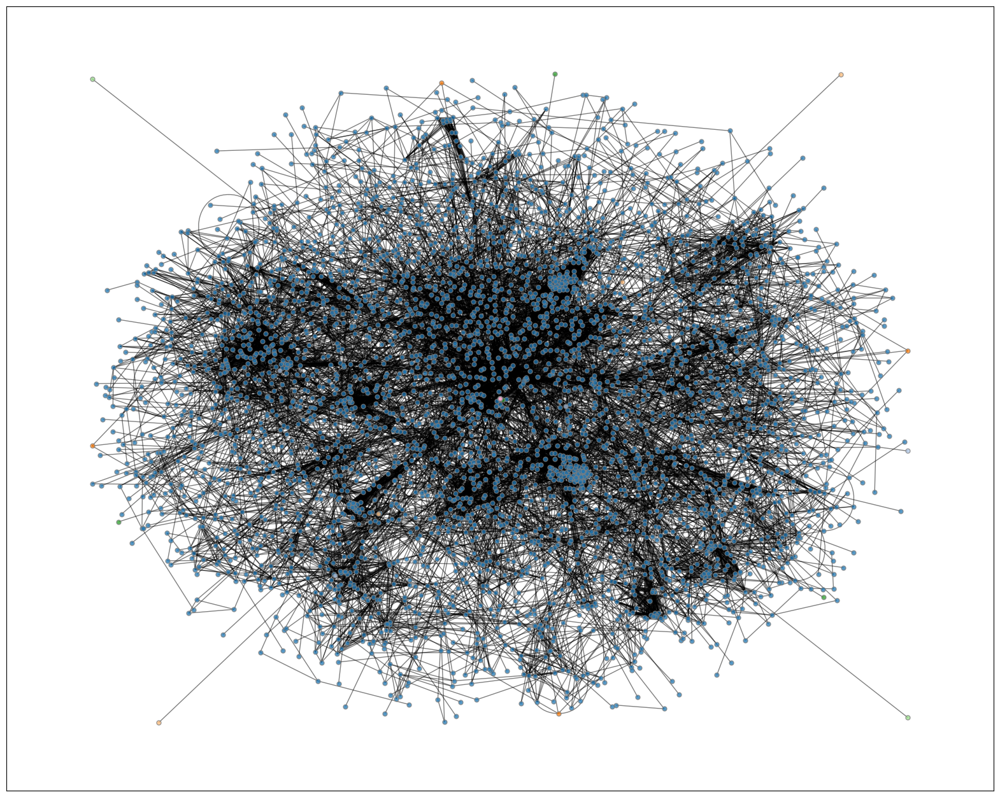

In [13]:
# removing random nodes
def rem_nodes(G, num_remove):

    G_copy = G.copy()
    nodes_to_remove = num_remove
    G_copy.remove_nodes_from(nodes_to_remove)

    # sort components
    components = sorted(nx.connected_components(G_copy), key=len, reverse=True)
    # Different color for each component
    component_colors = {}
    for i, component in enumerate(components):
        component_colors[tuple(component)] = f"C{i}"

    if not components:
        return None


    # Create a dictionary to store color for each component
    color_palette = plt.get_cmap("tab20").colors

    size = 20
    fig, ax = plt.subplots(figsize=(size, size-4))
    title = "Effect of removing Random nodes"

    for i, component in enumerate(components):

      subgraph = G.subgraph(component)
      pos = nx.spring_layout(subgraph, k=0.1, seed=42)
      node_colors = color_palette[i % len(color_palette)]


      # nodes
      options = {"edgecolors": "tab:gray", "node_size": 25, "alpha": 0.75}
      nx.draw_networkx_nodes(subgraph, pos,node_color=node_colors, **options)

      # edges
      nx.draw_networkx_edges(subgraph, pos, width=1.0, alpha=0.5)

    plt.show()


remove = np.random.randint(1, 101, size=100).tolist()
giant = rem_nodes(G,remove)

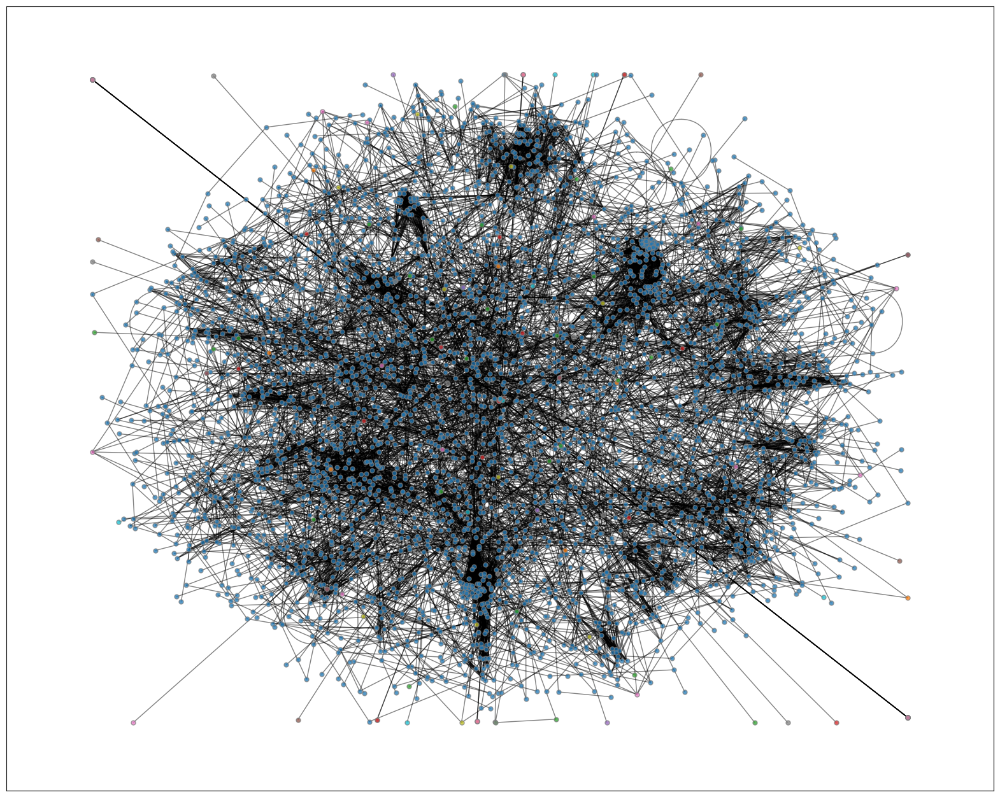

In [14]:
def rem_nodes_HD(G):
    #removing high centrality nodes
    pagerank = nx.pagerank(G)
    top = sorted(pagerank.items(), key=lambda x: x[1], reverse=True)[:100]
    G_copy = G.copy()

    nodes_to_remove = []
    for node, x in top:
      nodes_to_remove.append(node)
    G_copy.remove_nodes_from(nodes_to_remove)

    components = list(nx.connected_components(G_copy))
    largest_component = None
    if components:
        largest_component = max(components, key=len)

    # Different color for each component
    component_colors = {}
    for i, component in enumerate(components):
        component_colors[tuple(component)] = f"C{i}"

    size = 20
    title = "Effect of removing Random nodes"
    fig, ax = plt.subplots(figsize=(size, size-4))


    if not components:
        return "No connected components"
    for i, component in enumerate(components):
        subgraph = G_copy.subgraph(component)
        pos = nx.spring_layout(subgraph, k=0.1, seed=42)


        # nodes
        options = {"edgecolors": "tab:gray", "node_size": 25, "alpha": 0.75}
        nx.draw_networkx_nodes(subgraph, pos, node_color=component_colors[tuple(component)], **options)

        # edges
        nx.draw_networkx_edges(subgraph, pos, width=1.0, alpha=0.5)

plt.show()
rem_nodes_HD(G)


# Comparison with Random Graphs

# **Erdos Renyi**
This script generates an ER random graph with the same number of nodes and edges as the original network.
The computed statistics will be compared to those of the real network.


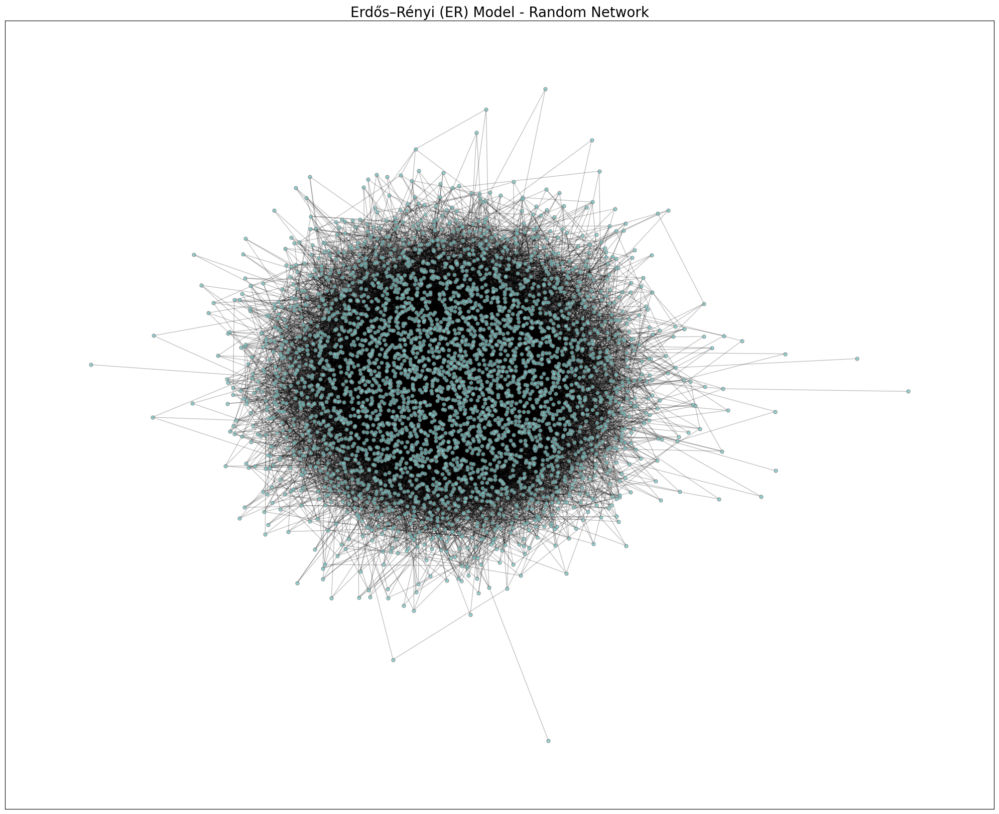

In [15]:
# Generate an Erdős–Rényi (ER) random graph with a similar number of nodes and edges
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()

# Probability of edge creation
p = num_edges / (num_nodes * (num_nodes - 1) / 2)

ER_G = nx.erdos_renyi_graph(num_nodes, p)

# Graph Visualization
size = 20
title = "Erdős–Rényi (ER) Model - Random Network"
fig, ax = plt.subplots(figsize=(size, size-4))
# positions for all nodes
pos = nx.spring_layout(ER_G, seed=42)

# Nodes
options = {"edgecolors": "tab:gray", "node_size": 25, "alpha": 0.75}
nx.draw_networkx_nodes(ER_G, pos, node_color=["#76c8c8"], **options)

# Edges
nx.draw_networkx_edges(ER_G, pos, width=1.0, alpha=0.25)

plt.tight_layout()
plt.title(title, fontsize=20)
plt.axis("on")
plt.show()

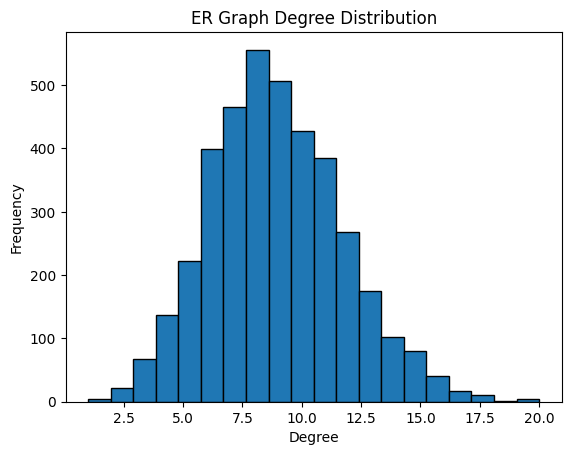

In [16]:
# Degree Distribution
degrees = [deg for _, deg in ER_G.degree()]
plt.hist(degrees, bins=20, edgecolor='black')
plt.xlabel("Degree")
plt.ylabel("Frequency")
plt.title("ER Graph Degree Distribution")
plt.show()


In [17]:
# Connected Components Analysis
largest_subgraph = concomp(ER_G)

Number of connected components: 1
Largest component size: 3892


In [18]:
# Clustering Coefficient & Density
cluster_coef(ER_G)

Average Clustering Coefficient: 0.002310894130085838
Network Density: 0.002274202226499448


In [19]:
# Path Analysis
path_an(ER_G)

Average shortest path length: 4.035591528979702
Network Diameter: 7


In [20]:
#  Degree Centrality
degree_centrality_ER = nx.degree_centrality(ER_G)
top_degree_ER = sorted(degree_centrality_ER.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Degree Centrality (ER):")
for node, value in top_degree_ER:
    print(f"Score: {value}")


Top 5 nodes by Degree Centrality (ER):
Score: 0.005140066820868671
Score: 0.005140066820868671
Score: 0.005140066820868671
Score: 0.005140066820868671
Score: 0.005140066820868671


In [21]:
# Betweenness Centrality
betweenness_centrality_ER = nx.betweenness_centrality(ER_G)
top_betweenness_ER = sorted(betweenness_centrality_ER.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Betweenness Centrality (ER):")
for node, value in top_betweenness_ER:
    print(f"Score: {value}")



Top 5 nodes by Betweenness Centrality (ER):
Score: 0.003735964875865137
Score: 0.0036102439101956376
Score: 0.003368527102060045
Score: 0.00324863201260628
Score: 0.00322332608426186


In [22]:
# Closeness Centrality
closeness_centrality_ER = nx.closeness_centrality(ER_G)
top_closeness_ER = sorted(closeness_centrality_ER.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Closeness Centrality (ER):")
for node, value in top_closeness_ER:
    print(f"Score: {value}")


Top 5 nodes by Closeness Centrality (ER):
Score: 0.27950578263055814
Score: 0.2767819035424669
Score: 0.27642796248934354
Score: 0.27595744680851064
Score: 0.27552754567341736


In [23]:
# Eigenvector Centrality
eigenvector_centrality_ER = nx.eigenvector_centrality(ER_G, max_iter=1000)
top_eigenvector_ER = sorted(eigenvector_centrality_ER.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Eigenvector Centrality (ER):")
for node, value in top_eigenvector_ER:
    print(f"Score: {value}")


Top 5 nodes by Eigenvector Centrality (ER):
Score: 0.04399766548481675
Score: 0.039631210573567874
Score: 0.03953252352234129
Score: 0.03920855629838218
Score: 0.03910876106654788


In [24]:
# PageRank
pagerank_ER = nx.pagerank(ER_G)
top_pagerank_ER = sorted(pagerank_ER.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by PageRank (ER):")
for node, value in top_pagerank_ER:
    print(f"Score: {value}")


Top 5 nodes by PageRank (ER):
Score: 0.0005285989911799672
Score: 0.0005278650744455251
Score: 0.0005216116296934807
Score: 0.0005193579843039936
Score: 0.000515155325800437


Results :
**Degree Distribution:**



*   The ER graph's degree distribution is more uniform compared to the real network.
*   The ER graph follows a binomial degree distribution,but the real network does not


**Connected Components:**

The ER model 3 connected component, unlike the real network which only has one

**Path Analysis:**

The average shortest path length in the ER model is much smaller compared to the real-world network.
The diameter is lower than in the real network, meaning nodes are more evenly connected.


**Clustering and Density:**

The clustering coefficient is much lower in the ER model (~0.002-0.01).
The density is higher because ER graphs tend to have a more uniform edge distribution.

**Centrality Analysis:**

Degree Centrality: ER graphs don’t have hubs like the real network; most nodes have similar degrees.
Betweenness Centrality: ER graphs don’t form bottlenecks, leading to much lower betweenness values.
Closeness Centrality: Similar across nodes since distances between them are more uniform.
Eigenvector Centrality: No dominant influencers since connections are more random.
PageRank: PageRank values are more evenly distributed.

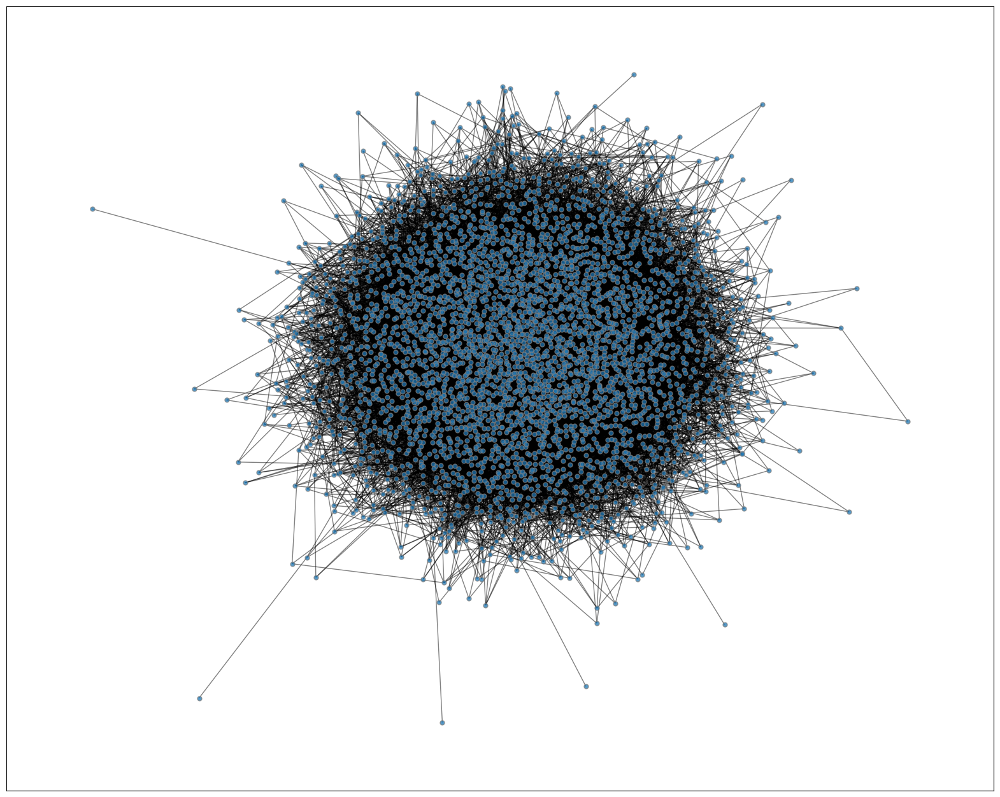

In [25]:
#removing Random nodes
rem_nodes(ER_G,remove)

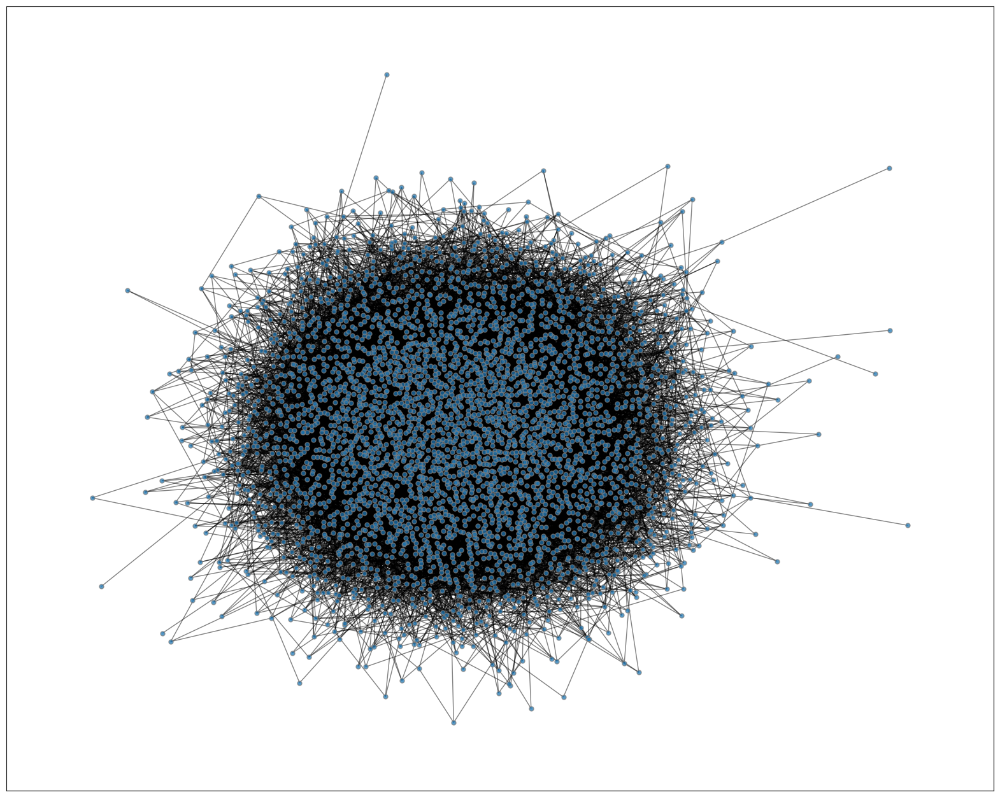

In [26]:
#removing high degree nodes
rem_nodes_HD(ER_G)

# **Barabasi Albert**


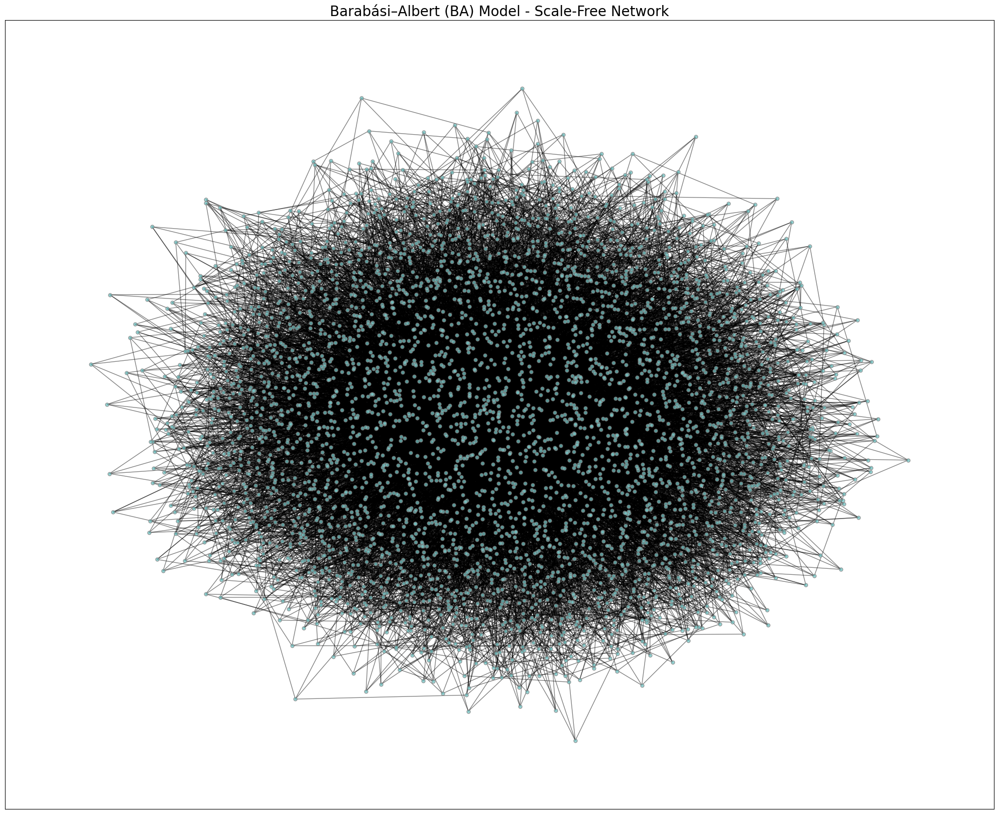

In [27]:
# Generate a Barabási–Albert (BA) scale-free network with a similar number of nodes and edges
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()
m = num_edges // num_nodes  # Number of edges to attach per new node

BA_G = nx.barabasi_albert_graph(num_nodes, m)

# Graph Visualization
size = 20
title = "Barabási–Albert (BA) Model - Scale-Free Network"
fig, ax = plt.subplots(figsize=(size, size-4))
pos = nx.spring_layout(BA_G, seed=42)  # positions for all nodes

# Nodes
options = {"edgecolors": "tab:gray", "node_size": 25, "alpha": 0.75}
nx.draw_networkx_nodes(BA_G, pos, node_color=["#76c8c8"], **options)

# Edges
nx.draw_networkx_edges(BA_G, pos, width=1.0, alpha=0.5)

plt.tight_layout()
plt.title(title, fontsize=20)
plt.axis("on")
plt.show()

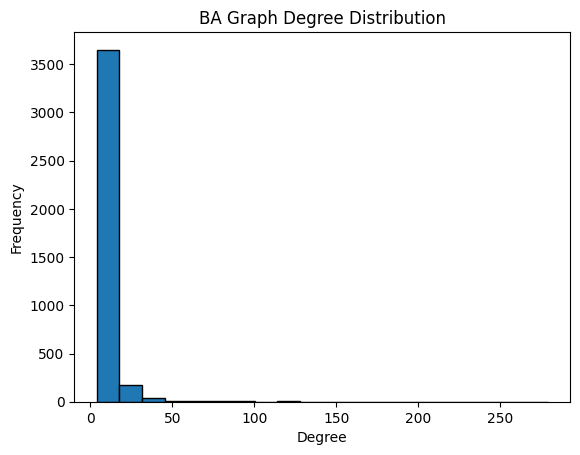

In [28]:
# Degree Distribution
degrees = [deg for _, deg in BA_G.degree()]
plt.hist(degrees, bins=20, edgecolor='black')
plt.xlabel("Degree")
plt.ylabel("Frequency")
plt.title("BA Graph Degree Distribution")
plt.show()

In [29]:
# Clustering Coefficient & Density
cluster_coef(BA_G)

Average Clustering Coefficient: 0.015004247751445248
Network Density: 0.0020539136484622193


In [30]:
# Connected Components Analysis
largest_subgraph = concomp(BA_G)

Number of connected components: 1
Largest component size: 3892


In [31]:
# Path Analysis
path_an(BA_G)

Average shortest path length: 3.5868986934034663
Network Diameter: 6


In [32]:
#  Degree Centrality
degree_centrality_BA = nx.degree_centrality(BA_G)
top_degree_BA = sorted(degree_centrality_BA.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Degree Centrality (BA):")
for node, value in top_degree_BA:
    print(f"Score: {value}")



Top 5 nodes by Degree Centrality (BA):
Score: 0.07170393215111796
Score: 0.05911076843998972
Score: 0.03957851452068877
Score: 0.033667437676689796
Score: 0.033667437676689796


In [33]:
# Betweenness Centrality
betweenness_centrality_BA = nx.betweenness_centrality(BA_G)
top_betweenness_BA = sorted(betweenness_centrality_BA.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Betweenness Centrality (BA):")
for node, value in top_betweenness_BA:
    print(f"Score: {value}")


Top 5 nodes by Betweenness Centrality (BA):
Score: 0.15584706982152816
Score: 0.1008326794485776
Score: 0.06180948454236604
Score: 0.05466005857413348
Score: 0.04646024232390539


In [34]:
#  Closeness Centrality
closeness_centrality_BA = nx.closeness_centrality(BA_G)
top_closeness_BA = sorted(closeness_centrality_BA.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Closeness Centrality (BA):")
for node, value in top_closeness_BA:
    print(f" Score: {value}")


Top 5 nodes by Closeness Centrality (BA):
 Score: 0.443823428766967
 Score: 0.41834211375120955
 Score: 0.40603151413962224
 Score: 0.40129950495049505
 Score: 0.38976259641390365


In [35]:
#  Eigenvector Centrality
eigenvector_centrality_BA = nx.eigenvector_centrality(BA_G, max_iter=1000)
top_eigenvector_BA = sorted(eigenvector_centrality_BA.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Eigenvector Centrality (BA):")
for node, value in top_eigenvector_BA:
    print(f"Score: {value}")



Top 5 nodes by Eigenvector Centrality (BA):
Score: 0.41903466219004554
Score: 0.29212612205440486
Score: 0.1787860758604895
Score: 0.17068777224078743
Score: 0.14097806590999776


In [36]:
# PageRank
pagerank_BA = nx.pagerank(BA_G)
top_pagerank_BA = sorted(pagerank_BA.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by PageRank (BA):")
for node, value in top_pagerank_BA:
    print(f"Score: {value}")


Top 5 nodes by PageRank (BA):
Score: 0.007631029584965902
Score: 0.0063080903958471065
Score: 0.004248437569910065
Score: 0.003611175387037629
Score: 0.0035749624257699892


Degree Distribution:

The real network has a steep drop in degree distribution, same as BA.
The BA model produces similar degree distribution as observed in the real network.

Connected Components:

Both networks are fully connected, meaning every node is reachable from any other.

Shortest Path & Diameter:

The BA model has a much shorter average shortest path length (3.62 < 6.27) and a smaller diameter (6 < 20).
This suggests the real network has longer-range connections, whereas the BA model has paths that are shorter.

Clustering Coefficient:

The real network (0.37) has a much higher clustering coefficient than the BA model (0.0128).
This means the real network has more local communities, while the BA model forms weak local clustering.

Network Density:

Both have similar density (~0.0023 real vs. ~0.0020 BA), that means they have similar connectivity levels.

Centrality Measures:

In both networks, the top-ranked nodes in degree, betweenness, and eigenvector centrality act as major hubs.
However, the BA model overemphasizes the importance of a few nodes, leading to higher concentration of influence compared to the real-world distribution.

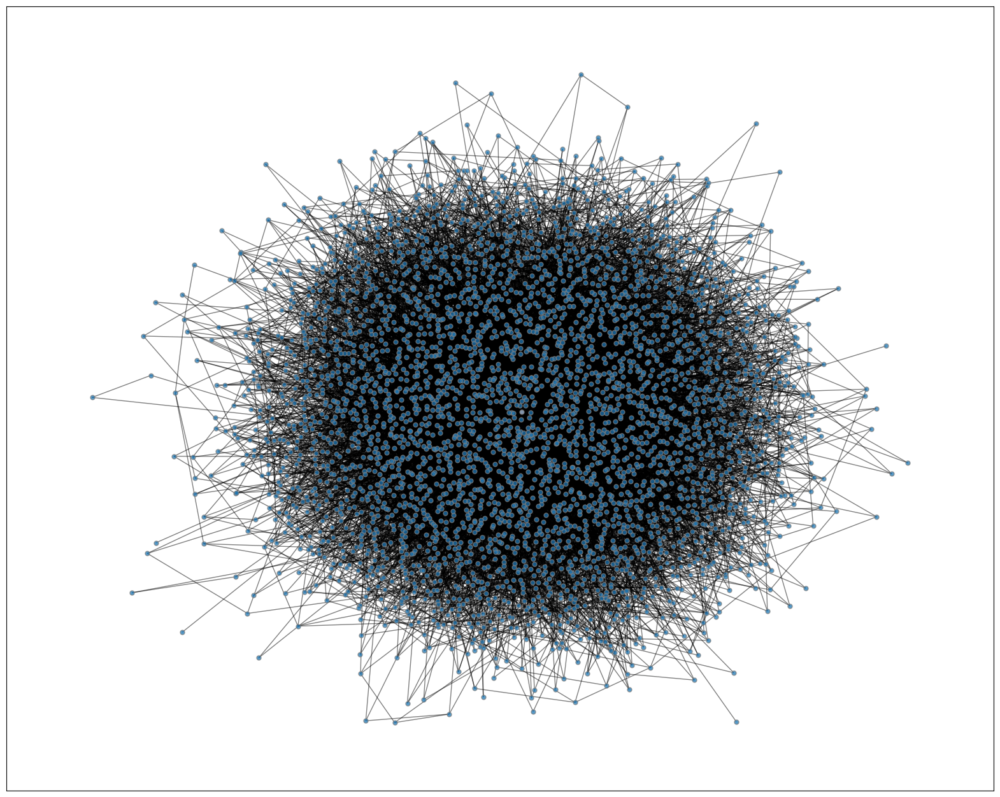

In [37]:
#removing random nodes
rem_nodes(BA_G,remove)

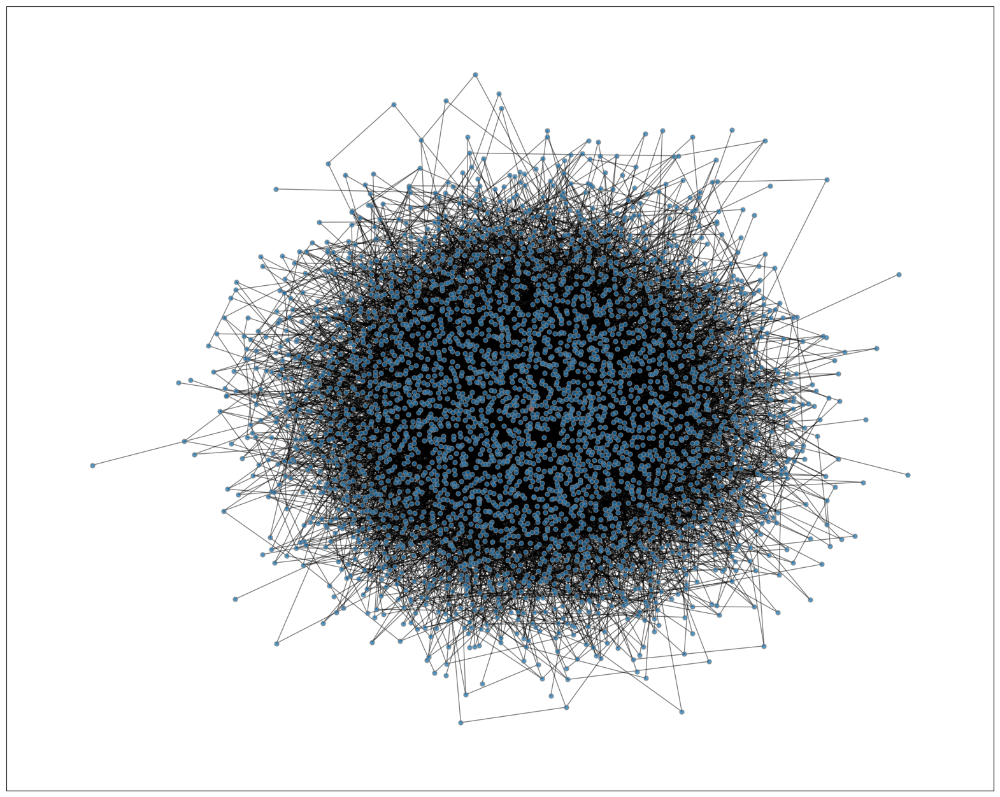

In [38]:
#removing nodes with high centrality
rem_nodes_HD(BA_G)

# Watts-Strogatz

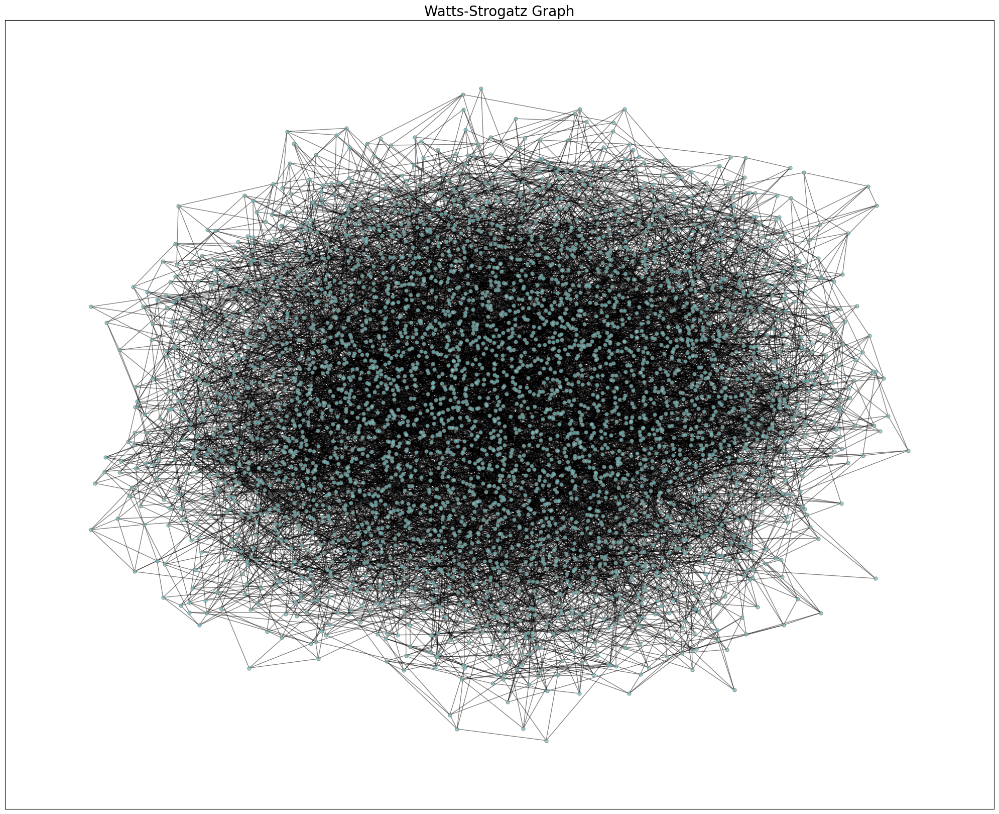

In [39]:
# Graph Visualization
size = 20
title = "FB pages of TV Shows that interacted with each other"

# Watts-Strogatz Graph
WS = nx.watts_strogatz_graph(n=len(G.nodes()), k=6, p=0.3)
fig, ax = plt.subplots(figsize=(size, size-4))
pos = nx.spring_layout(WS, seed=42)

nx.draw_networkx_nodes(WS, pos, node_color=["#76c8c8"], **options)
nx.draw_networkx_edges(WS, pos, width=1.0, alpha=0.5)

plt.tight_layout()
plt.title("Watts-Strogatz Graph", fontsize=20)
plt.axis("on")
plt.show()


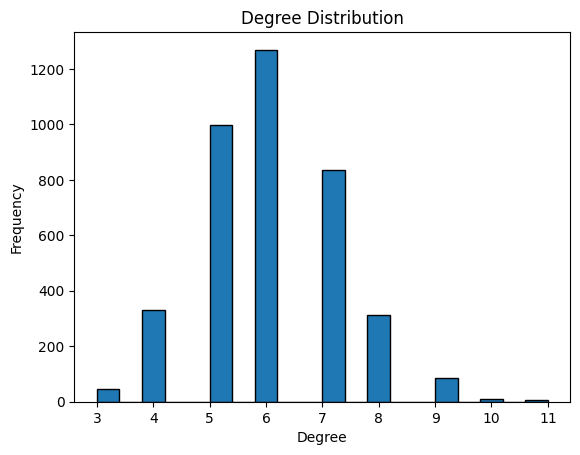

In [40]:
# Degree distribution
degrees = [deg for _, deg in WS.degree()]
plt.hist(degrees, bins=20, edgecolor='black')
plt.xlabel("Degree")
plt.ylabel("Frequency")
plt.title("Degree Distribution")
plt.show()


In [41]:
# Connected Components Analysis
largest_subgraph = concomp(WS)

Number of connected components: 1
Largest component size: 3892


In [42]:
# Path Analysis
path_an(WS)

Average shortest path length: 5.632982324350895
Network Diameter: 9


In [43]:
# Clustering Coefficient & Density
cluster_coef(WS)
# avg_clustering = nx.average_clustering(G)
# density = nx.density(G)
# print(f"Average Clustering Coefficient: {avg_clustering}")
# print(f"Network Density: {density}")

Average Clustering Coefficient: 0.21111745112258987
Network Density: 0.0015420200462606013


In [44]:
# Degree Centrality
degree_centrality = nx.degree_centrality(WS)
top_degree = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Degree Centrality:")
for node, value in top_degree:
    print(f"Score: {value}")


Top 5 nodes by Degree Centrality:
Score: 0.002827036751477769
Score: 0.002827036751477769
Score: 0.002827036751477769
Score: 0.002827036751477769
Score: 0.002827036751477769


In [45]:
#  Betweenness Centrality
betweenness_centrality = nx.betweenness_centrality(WS)
top_betweenness = sorted(betweenness_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Betweenness Centrality:")
for node, value in top_betweenness:
    print(f"Score: {value}")


Top 5 nodes by Betweenness Centrality:
Score: 0.0054932865802913965
Score: 0.005441231467848411
Score: 0.00541260317525581
Score: 0.005052699172556819
Score: 0.004928841193024068


In [46]:
#  Closeness Centrality
closeness_centrality = nx.closeness_centrality(WS)
top_closeness = sorted(closeness_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Closeness Centrality:")
for node, value in top_closeness:
    name = G.nodes[node]["name"]
    print(f"Score: {value}")


Top 5 nodes by Closeness Centrality:
Score: 0.20014402551309088
Score: 0.19905867908118893
Score: 0.19840905614196114
Score: 0.1973423948876604
Score: 0.19708251025679988


In [47]:
#  Eigenvector Centrality
eigenvector_centrality = nx.eigenvector_centrality(WS)
top_eigenvector = sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by Eigenvector Centrality:")
for node, value in top_eigenvector:
    print(f" Score: {value}")


Top 5 nodes by Eigenvector Centrality:
 Score: 0.03777994101418226
 Score: 0.037084233204910354
 Score: 0.036450957673683865
 Score: 0.03621058464493368
 Score: 0.0358449136899236


In [48]:
# PageRank
pagerank = nx.pagerank(WS)
top_pagerank = sorted(pagerank.items(), key=lambda x: x[1], reverse=True)[:5]
print("\nTop 5 nodes by PageRank:")
for node, value in top_pagerank:
    print(f"Score: {value}")


Top 5 nodes by PageRank:
Score: 0.00043421261296266664
Score: 0.00043410812202030136
Score: 0.00043214570966852906
Score: 0.00043208230428147266
Score: 0.0004307180907198574


Comparison with Real Network:
 The Watts-Strogatz (WS) model exhibits high clustering similar to the real network, but it has a longer shortest path and diameter, thus, it is less efficient in connectivity.

Degree Distribution:
 Unlike the real network's skewed distribution, WS has a more uniform degree spread, that means it is highly connected.
Centrality Differences:
 The WS model distributes centrality more evenly across nodes, while the real network has distinct influential hubs.
Graph Structure:
The WS network maintains small-world properties but lacks the scale-free nature observed in real-world networks like Facebook TV show interactions.

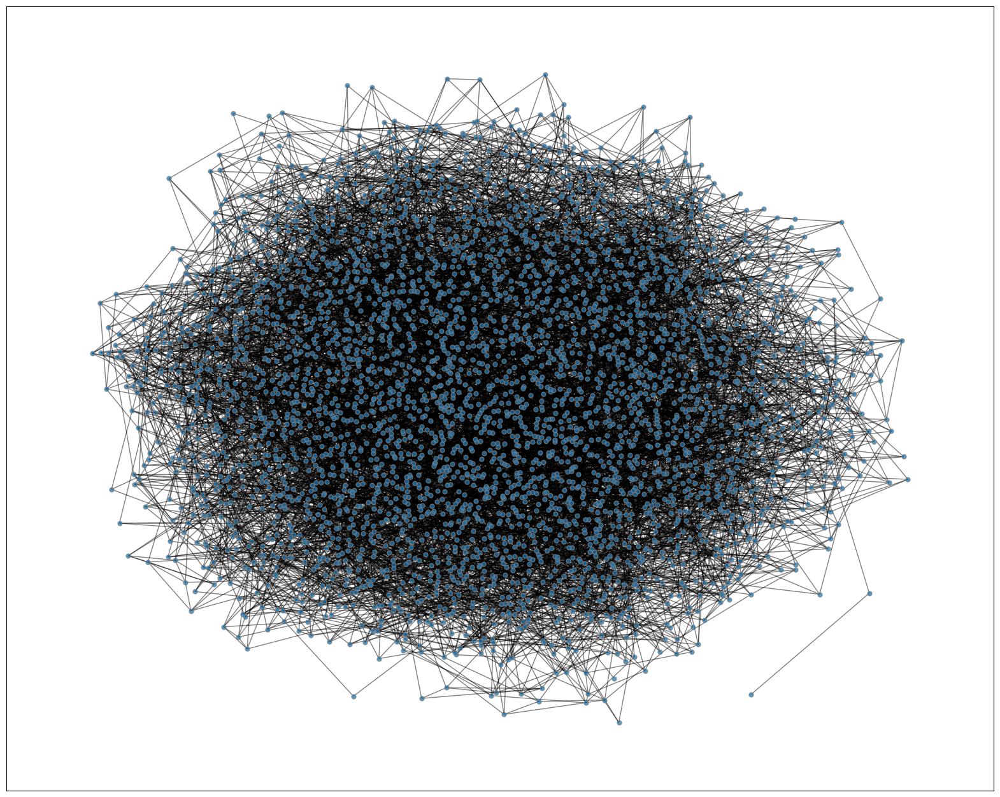

In [49]:
#removing random nodes
rem_nodes(WS, remove)

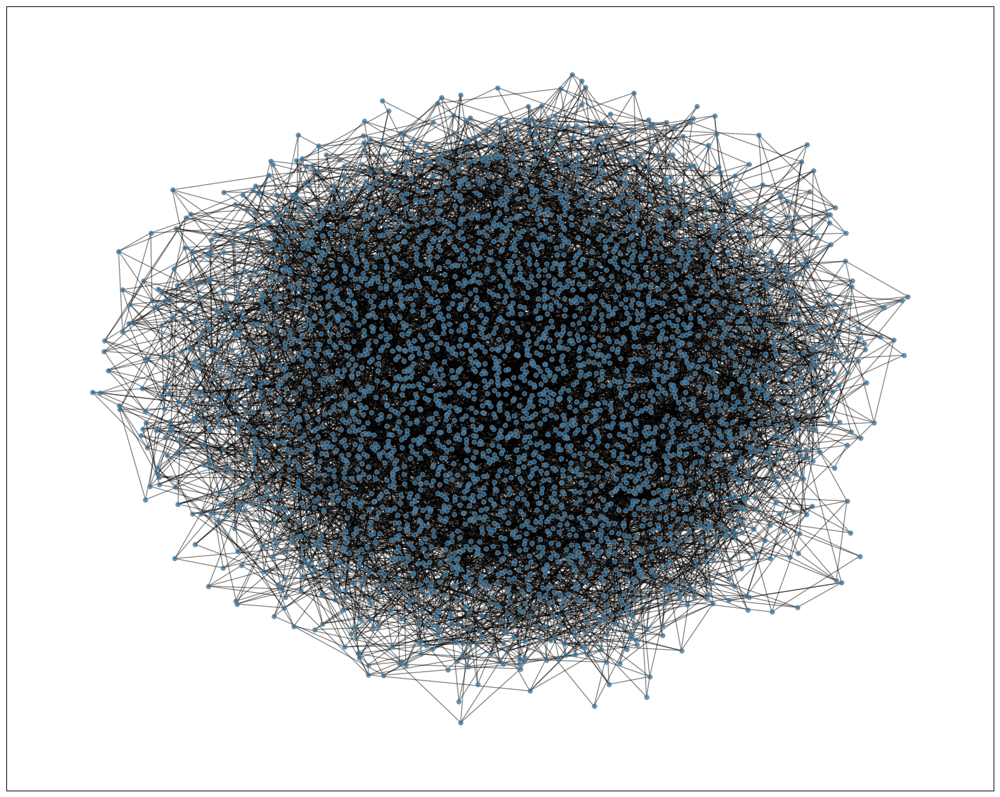

In [50]:
# removing nodes with high centrality
rem_nodes_HD(WS)

# Research Question

**Different Communities Present within**

Number of communities detected (Louvain): 48


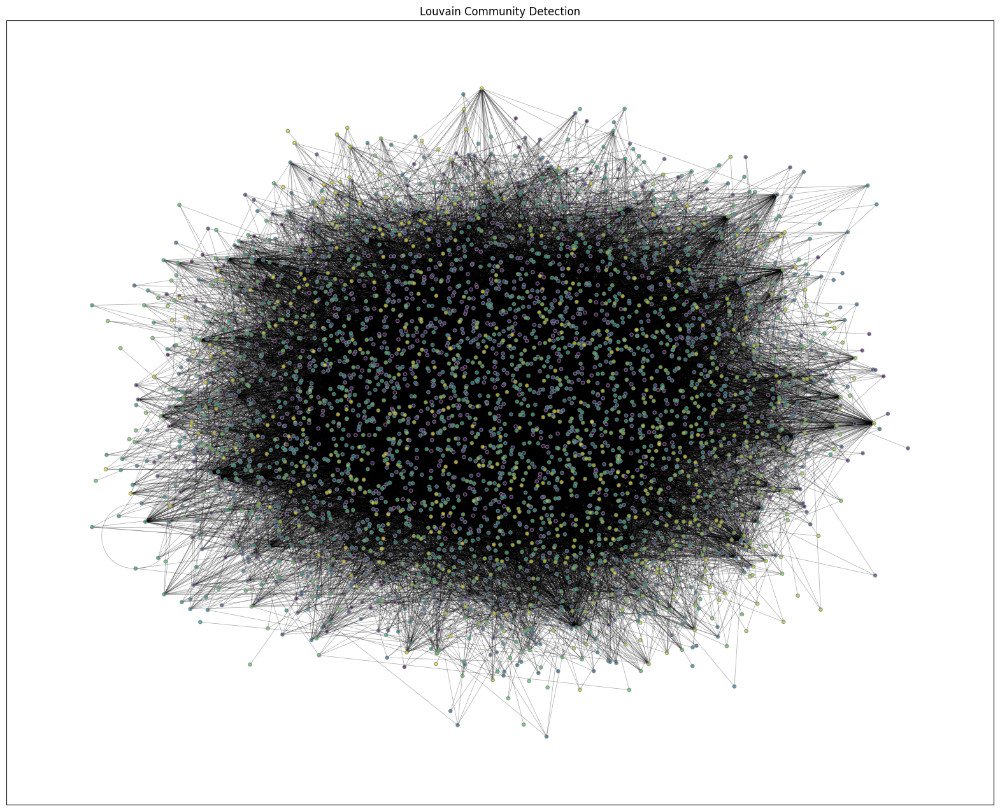

In [65]:
# Community Detection using Louvain Algorithm
partition =nx.community.louvain_communities(G, resolution=1, threshold=1e-07, max_level=None, seed=None)
num_communities = len(partition)
print(f"Number of communities detected (Louvain): {num_communities}")

# Assign colors to communities
# Assign colors based on partition
colors = []
for node in G.nodes():
    colors.append(node)
fig, ax = plt.subplots(figsize=(size, size-4))
# nx.draw(G, pos, node_color=colors, cmap=plt.cm.viridis, node_size=15, edge_color='gray', alpha=0.5)

# nodes
options = {"edgecolors": "tab:gray", "node_size": 15, "alpha": 0.75}
nx.draw_networkx_nodes(G, pos, node_color=colors,cmap=plt.cm.viridis, **options)

# edges
nx.draw_networkx_edges(G, pos, width=0.6, alpha=0.3)
plt.title("Louvain Community Detection")
plt.show()



**Conclusion**
The Louvain algorithm detected multiple densely connected communities within the TV show network. These communities(represented by clusters of different colors) likely represent genre-based groupings (e.g., reality shows, dramas, or comedies) or TV shows that share the same audience. The visualization highlights well-defined clusters as well as some highly interconnected hubs and a few isolated branches. This suggests that although many TV shows share strong mutual interactions, some remains very niche i.e. niche fan bases or less mainstream content.


**Which are the most Influential Nodes**

/usr/local/lib/python3.11/dist-packages/networkx/drawing/nx_pylab.py:457: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  node_collection = ax.scatter(


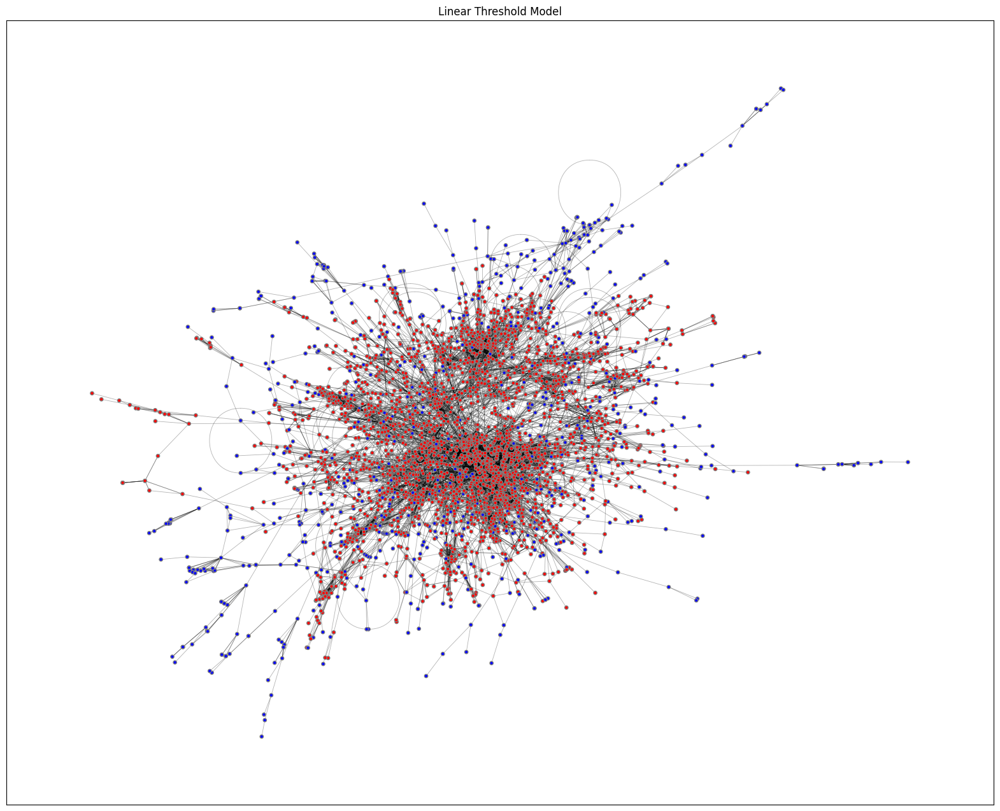

In [66]:
def linear_threshold_model(G, snodes):
    # Assign random thresholds
    thresholds = {}
    for node in G.nodes:
        thresholds[node] = np.random.uniform(0, 1)

    # Assign random edge weights
    weights = {}
    for edge in G.edges:
        weights[edge] = np.random.uniform(0, 1)

    # Initialize active nodes
    active_nodes = set(snodes)

    # Iterative activation process
    newly_activated = True
    while newly_activated:
        newly_activated = False

        # Nodes that are not yet active
        inactive_nodes = set(G.nodes) - active_nodes

        for node in inactive_nodes:
            total_weight = 0

            for neighbor in G.neighbors(node):
                if neighbor in active_nodes:
                    total_weight += weights.get((neighbor, node), 0)
                    total_weight += weights.get((node, neighbor), 0)

            if total_weight >= thresholds[node]:
                active_nodes.add(node)
                newly_activated = True

    return active_nodes


# Select initial seed nodes randomly
seed_nodes = np.random.choice(G.nodes, size=5, replace=False)

# Run the model
final_active_nodes = linear_threshold_model(G, seed_nodes)

# Assign colors based on activation
node_colors = []
for node in G.nodes:
    if node in final_active_nodes:
        node_colors.append("red")
    else:
        node_colors.append("blue")

# Draw the graph
fig, ax = plt.subplots(figsize=(size, size-4))
pos = nx.spring_layout(G, seed=42)
# nodes
options = {"edgecolors": "tab:gray", "node_size": 15}
nx.draw_networkx_nodes(G, pos, node_color=node_colors,cmap=plt.cm.viridis, **options)

# edges
nx.draw_networkx_edges(G, pos, width=0.6, alpha=0.3)
plt.title("Linear Threshold Model")
plt.show()


**Conclusion**
This Models shows the spread of influence in the given network. Initially, a few nodes were activated, and through the iterative process, influence spread to neighboring nodes based on their threshold and incoming edge weights.
The most influential nodes are those in the dense central regions, where influence spreads rapidly due to high connectivity. These nodes activate many others, triggering a cascade effect. In contrast, peripheral nodes remain mostly inactive due to weaker connections.

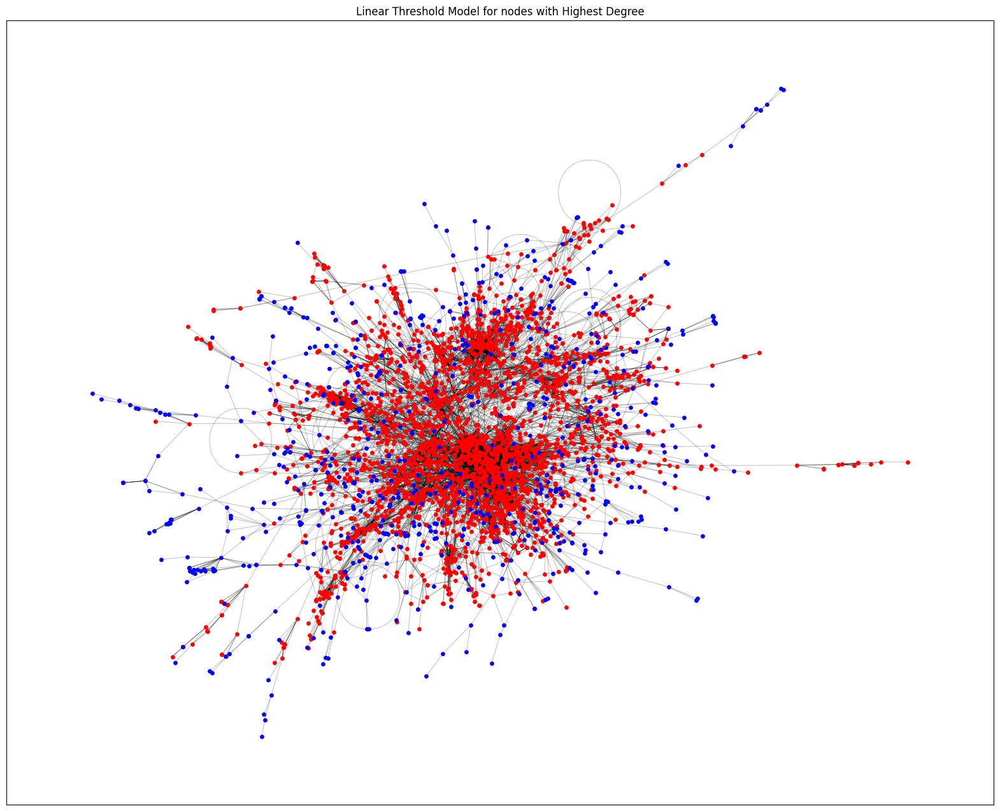

In [67]:
# Linear Threshold Model with Top 5 High-Degree Nodes

# Assign random thresholds and weights
thresholds = {}
weights = {}
for node in G.nodes():
    thresholds[node] = np.random.uniform(0, 1)
    weights[node] = {}
    for neighbor in G.neighbors(node):
        weights[node][neighbor] = np.random.uniform(0, 1)

# Select top 5 pagerank nodes
page_dict = dict(nx.pagerank(G))
top_nodes = sorted(page_dict, key=page_dict.get, reverse=True)[:5]

# Initialize active set
active_nodes = set(top_nodes)
newly_active = set(top_nodes)

# Spread activation
while newly_active:
    next_active = set()
    for node in G.nodes():
        if node not in active_nodes:
            influence = sum(weights[node].get(n, 0) for n in G.neighbors(node) if n in active_nodes)
            if influence >= thresholds[node]:
                next_active.add(node)
    newly_active = next_active
    active_nodes.update(newly_active)

# Visualization
fig, ax = plt.subplots(figsize=(size, size-4))
pos = nx.spring_layout(G, seed=42)
nx.draw_networkx_edges(G, pos,width=0.6, alpha=0.3)
nx.draw_networkx_nodes(G, pos, nodelist=active_nodes, node_color='red', node_size=15)
nx.draw_networkx_nodes(G, pos, nodelist=set(G.nodes()) - active_nodes, node_color='blue', node_size=15)
plt.title("Linear Threshold Model for nodes with Highest Degree")
plt.show()


**Conclusion:**

The PageRank-based Linear Threshold Model demonstrates a more strategic influence spread compared to random activation and high-degree selection. While high-degree nodes activated a large portion of the network, PageRank-selected nodes resulted in a more structured and efficient diffusion, activating key regions with higher centrality. This suggests that PageRank identifies influential nodes better than just relying on degree, leading to a more optimized spread of influence.

  Reference to the Dataset:
  @inproceedings{nr-aaai15,
      title = {The Network Data Repository with Interactive Graph Analytics and Visualization},
      author={Ryan A. Rossi and Nesreen K. Ahmed},
      booktitle = {Proceedings of the Twenty-Ninth AAAI Conference on Artificial Intelligence},
      url={http://networkrepository.com},
      year={2015}
  }